In [2]:
from astropy.io import fits
from astropy.io import ascii
import numpy as np
import matplotlib.pyplot as plt
from astropy.table import Column, Table, vstack
import tarfile
import os
import glob
from pathlib import Path
from scipy import interpolate
from scipy.interpolate import InterpolatedUnivariateSpline
import pdb

In [2]:
#random galaxy sample
hdul4 = fits.open('mangaHI-8243-3701-Copy1.fits')
hdul4.info()
hdu4 = hdul4[1]
hdr4 = hdul4[0].header 
hdr4 = hdul4[1].header
data4 = hdu4.data
cols4 = data4.columns
hdul4.close()
print(hdr4)

Filename: mangaHI-8243-3701-Copy1.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU       4   ()      
  1                1 BinTableHDU     39   1R x 3C   [940E, 940E, 940E]   
XTENSION= 'BINTABLE'           /Written by IDL:  Wed Mar 28 16:48:38 2018       BITPIX  =                    8 /                                                NAXIS   =                    2 /Binary table                                    NAXIS1  =                11280 /Number of bytes per row                         NAXIS2  =                    1 /Number of rows                                  PCOUNT  =                    0 /Random parameter count                          GCOUNT  =                    1 /Group count                                     TFIELDS =                    3 /Number of columns                               COMMENT                                                                         COMMENT  *** End of mandatory fields ***              

I began by naming the path to all relevant files and naming the group of files at that path. 

In [3]:
feel_location = os.path.join('/Users/Frank/KNAC_Internship/all_spectra', '**/*.fits')
feel_names = glob.glob(feel_location)
print('Only 4592 of these spectra files use SDSS plate-ifu naming convention.')

Only 4592 of these spectra files use SDSS plate-ifu naming convention.


My red geyser sample is 50 galaxies, and my control sample is 691 galaxies (as of 7/31/2020).

In [5]:
#red geyser (50) + control (691) samples
drip_location = os.path.join('/Users/Frank/KNAC_Internship/ALL_samples_spectra', '*.fits')
drip_names = glob.glob(drip_location)
print(len(drip_names))

741


Below I load all of the pipeline data on each galaxy. I made these in topcat by joining together separate tables from the MaNGA drpall, dapall, and HI pipelines in order to consolidate all of the information into one table per sample. NOTE: at the end of the process of putting together my control sample, 9 total galaxies disappeared from my samples (1 red geyser and 8 control galaxies). In other words, they were originally in my sample, but ended up not being in the spectra Dave sent to me. I don't know how they got in there in the first place, but that is what the comments in the following two cells mean. 

In [6]:
#red geyser sample drp info, but without the geyser that is not in gbt/alfalfa data
hdul1 = fits.open('joined_table_final.fits')
hdul1.info()
hdu1 = hdul1[1]
hdr1 = hdul1[0].header 
hdr1 = hdul1[1].header
data1 = hdu1.data
cols = data1.columns
hdul1.close()

Filename: joined_table_final.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU      16   (9055,)   uint8   
  1  Joined        1 BinTableHDU    259   50R x 122C   [K, 32A, 32A, 9A, 32A, 32A, 32A, 32A, 32A, 32A, 32A, D, D, D, D, D, D, D, K, D, K, D, D, 53A, K, 32A, K, D, D, D, D, D, D, D, D, D, D, D, K, K, K, D, D, D, D, K, K, K, K, 32A, K, 19A, K, K, K, D, D, D, D, D, D, D, D, D, D, D, D, D, D, D, D, K, K, K, 6A, K, K, D, D, 7D, 7D, 7D, D, D, D, D, 7D, D, D, 7D, 7D, 7D, 7D, D, D, D, D, 7D, 7D, E, 79A, E, E, E, E, E, E, E, E, E, E, E, E, E, E, E, E, E, E, E, E, E]   


In [7]:
#control sample drp info, but without 8 galaxies that aren't in gbt/alfalfa data
hdul = fits.open('controlll-take-22-final.fits')
hdul.info()
hdu = hdul[1]
hdr = hdul[0].header 
hdr = hdul[1].header
data = hdu.data
cols = data.columns
hdul.close()

Filename: controlll-take-22-final.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU      16   (5910,)   uint8   
  1  /Users/Frank/Desktop/KNAC_internship/controlll-take-22.fits#1    1 BinTableHDU    252   691R x 120C   [32A, 9A, 32A, 32A, 32A, 32A, 32A, 32A, D, D, D, D, D, D, D, K, D, K, D, D, 53A, K, 32A, K, D, D, D, D, D, D, D, D, D, D, D, K, K, K, D, D, D, D, K, K, K, K, 32A, K, 19A, K, K, K, D, D, D, D, D, D, D, D, D, D, D, D, D, D, D, D, K, K, K, 6A, K, K, D, D, 7D, 7D, 7D, D, D, D, D, 7D, D, D, 7D, 7D, 7D, 7D, D, D, D, D, 7D, 7D, E, 79A, E, E, E, E, E, E, E, E, E, E, E, E, E, E, E, E, E, E, E, E, E, D]   


Name path and group of files at that path for my red geyser and control sample.

In [8]:
geys_location = os.path.join('/Users/Frank/KNAC_Internship/geyser_sample_spectra', '*.fits')
geys_names = glob.glob(geys_location)
print(len(geys_names))

cont_location = os.path.join('/Users/Frank/KNAC_Internship/control_sample_spectra', '*.fits')
cont_names = glob.glob(cont_location)
print(len(cont_names))

50
691


I defined a function that would pull out the galaxy velocity, the HI flux, and the HI velocity from each spectra file. I also wrapped the correction of the HI velocity for galaxy velocity in this function. 

In [9]:
def read_spec(filnam): 
    sp = fits.open(filnam)
    s = sp[1]
    datat = s.data
    header = sp[1].header #; can use to pull out header data later if I want
    
    galv = header['OBJ_VEL']
    
    flux = datat['FHI']
    
    vel = datat['VHI']
    
    corrected_vel = vel-galv
    
    sp.close()
    
    return vel, flux, galv, corrected_vel

The fits file below is essentially the pipeline data for each galaxy in my samples all in one table instead of separated into two. 

In [10]:
#drpall file with ALL samples (50 RG and 691 controls) spectra info
hdul7 = fits.open('all-spec-info-final.fits')
hdul7.info()
hdu7 = hdul7[1]
hdr7 = hdul7[0].header 
hdr7 = hdul7[1].header
data7 = hdu7.data
cols = data7.columns
hdul7.close()

Filename: all-spec-info-final.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU      16   (6150,)   uint8   
  1  Joined        1 BinTableHDU    212   741R x 100C   [11A, K, 32A, 32A, 32A, 32A, 32A, 32A, 32A, 32A, 32A, 32A, D, D, D, D, D, D, D, K, D, K, D, D, 53A, K, 32A, K, D, D, D, D, D, D, D, D, D, D, D, K, K, K, D, D, D, D, K, K, K, K, 32A, K, 19A, K, K, K, D, D, D, D, D, D, D, D, D, D, D, D, D, D, D, D, K, K, K, 6A, K, K, D, D, 7D, 7D, 7D, D, D, D, D, 7D, D, D, 7D, 7D, 7D, 7D, D, D, D, D, 7D, 7D]   


I made a list of all of the red geyser galaxy velocities so that I could calculate the galaxy distance using the Hubble law. This calculation, and others, are performed as I compile my red geyser astropy table. See comments for specific calculation identification.

In [11]:
#running this loop/function here specifically to get galv of red geyser sample to use in distance calculation in following cell
redgalv_list = []
for f in geys_names: #goes through and pulls out VHI and FHI and galaxy velocity
    vel, flux, redgalv, corrected_vel = read_spec(f)
    redgalv_list.append(redgalv) #appends each galaxy velocity to list
    
redgalv_arr = np.array(redgalv_list)
print(len(redgalv_arr)) #checking to see if list is correct length

50


## Red Geyser Calculations

For viewing purposes, I put all of my calculations into an astropy table 'tebl' as opposed to loose arrays. 
I calculated the distance to each galaxy using Hubble's Law.
I calculated the distance scaling coefficient for flux using the following formula:

$\frac{M_{HI}}{M_*} = 2.36e5(\frac{distance}{Mpc})^2\frac{flux}{M_*}$. 

This scaling coefficient accounts for the distance of each galaxy as it affects our spectra. 
I calculated the noise scaling coefficient for flux using the following formula:

$\frac{1}{rms^2}$. 

$rms$ here is the noise data that originally comes from the HI-MaNGA database, but is referenced here in the table data1. 

For use in stacking later on, I converted the scaling coefficients-- referred to here as weights-- to arrays. I additionally calculated the sum of all of the rms weights in order to complete a weighted average in the stacking process later on. 

In [1]:
#RED GEYSER calculations into astropy table
c = 3e5 #km/s
H = 70 #km/s/Mpc
t=redgalv_arr/H #distance calculation using hubble law

tebl = Table() #create table
tebl['MANGAID'] = data1['plateifu_1']
tebl['M*'] = data1['nsa_elpetro_mass']
tebl['Distance [Mpc]'] = t
tebl['Scale for Flux'] = (2.36e5*((t)**2))/(data1['nsa_elpetro_mass']) #scaling factor for distance
tebl['RMS'] = 1/(((data1['RMS'])/1000)**2) #converted mJy to Jy, scaling factor for noise

#tebl.remove_row(25) #removing galaxy that disappeared in gbt/alfalfa data

np.set_printoptions(threshold=np.inf)
dat = np.array(tebl['Scale for Flux']) #distance weight
fat = np.array(tebl['RMS']) #rms weight 
wsum = np.sum(fat) #sum of rms weights to divide by later on in stacking loop
print(len(dat))
print(wsum)
print(fat)

NameError: name 'redgalv_arr' is not defined

Repeat process for control galaxies. 

In [14]:
#running this loop/function here specifically to get galv of control sample to use in distance calculation in following cell
contgalv_list = []
for f in cont_names: #goes through and pulls out VHI and FHI and galaxy velocity
    vel, flux, contgalv, corrected_vel = read_spec(f)
    contgalv_list.append(contgalv)
    
contgalv_arr = np.array(contgalv_list)
print(len(contgalv_arr))

691


## Control Galaxy Calculations

All of the calculations that I completed for the red geyser sample, I also completed for the control sample and compiled into an astropy table 'teebl'. 

In [15]:
#flux scaling control calculations into notebook
t1= contgalv_arr/H #distance calculation using hubble law

teebl = Table()
teebl['MANGAID'] = data['plateifu_1_2']
teebl['M*'] = data['nsa_elpetro_mass_2']
teebl['Distance [Mpc]'] = t1
teebl['Scale for Flux'] = (2.36e5*((t1)**2))/(data['nsa_elpetro_mass_2']) #scaling factor for distance
teebl['RMS'] = 1/(((data['RMS'])/1000)**2) #converted mJy to Jy, scaling factor for noise
#teebl.remove_row(49)
#teebl.remove_row(178)
#teebl.remove_row(242)
#teebl.remove_row(262)
#teebl.remove_row(373)
#teebl.remove_row(374)
#teebl.remove_row(405)
#teebl.remove_row(532)
#tebl.show_in_notebook()

np.set_printoptions(threshold=np.inf)
dat2 = np.array(teebl['Scale for Flux']) #distance weight
fat2 = np.array(teebl['RMS']) #rms weight
wsum2 = np.sum(fat2) #sum of rms weights to divide by in stacking loop later
print(len(dat2))
print(wsum2)

691
188949500.0


## Initial Graphing Stages

I began by creating a nested for loop that would run through all of my spectra (at drip_location in group drip_names), use the function read_spec(f) to pull out my x and y data, and label the graph according to the specific spectra file it opened. 

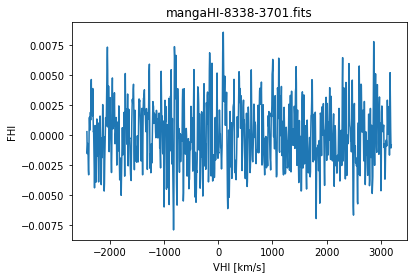

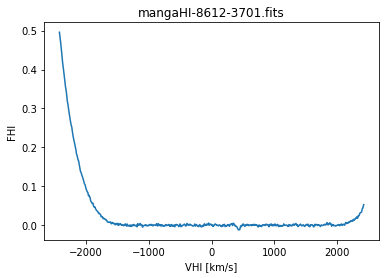

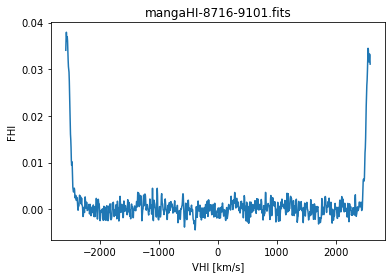

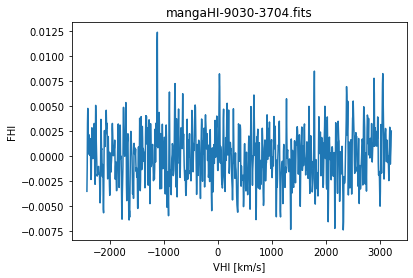

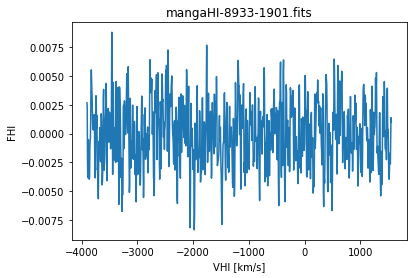

...

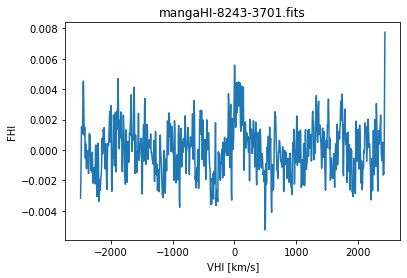

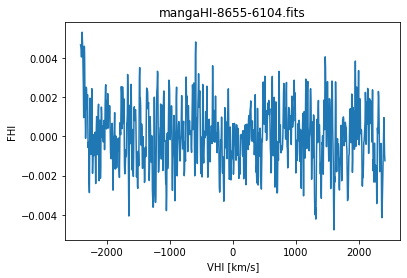

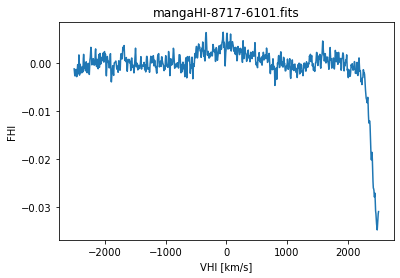

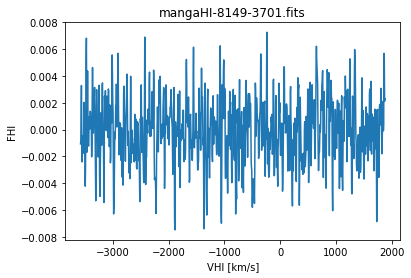

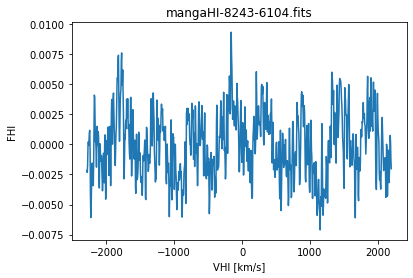

In [17]:
#plotting original (unscaled flux and velocity) samples data
for f in drip_names: #goes through and pulls out VHI and FHI and galaxy velocity
    vel, flux, galv, corrected_vel = read_spec(f)
    x = corrected_vel
    y = flux
    for i in range(len(x)):
        plt.figure()
        plt.plot(x[i],y[i])
        fname = os.path.basename(f)
        plt.title(fname)
        plt.xlabel('VHI [km/s]')
        plt.ylabel('FHI')
    # Figures not saved yet
        plt.show()
        plt.close()
    #break

Next, I created an interpolated function based off of each spectra, as well as a new standard x (new_x2). It helped me to think of this as redefining the VHI data (or domain) so that the spectra is graphed as if each galaxy's FHI data was measured at the same set of VHI values (or x coordinates). This essentially sets us up for stacking. 

The interpolation function, int_func, was applied to this standard set of VHI (or x-values) to produce the corresponding set of FHI data (new_y2) (or y-values). This FHI data was dropped into the list d, and I overplotted new_y2 v new_x2 on top of our original spectra to ensure that the data remained consistent. Success!

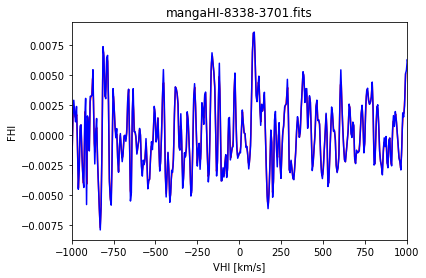

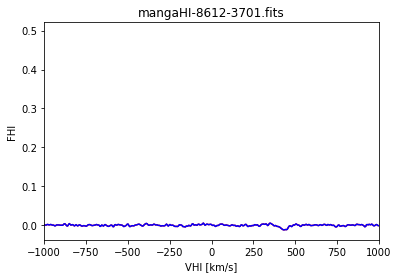

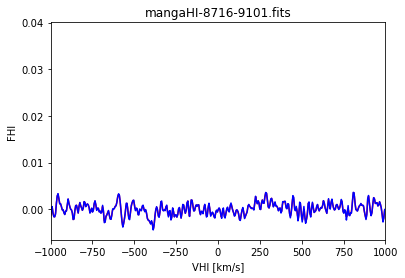

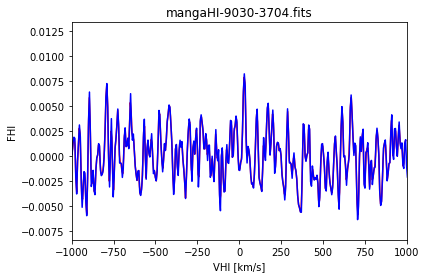

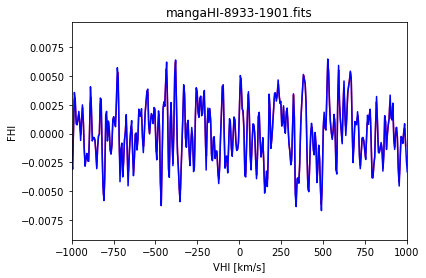

...

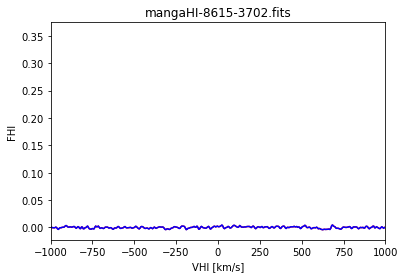

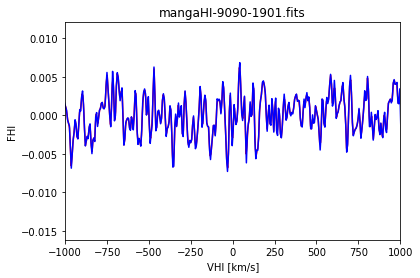

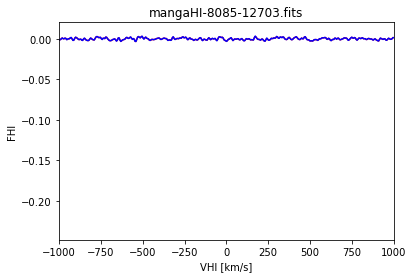

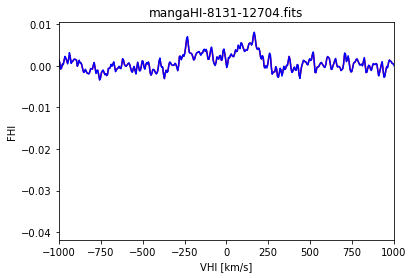

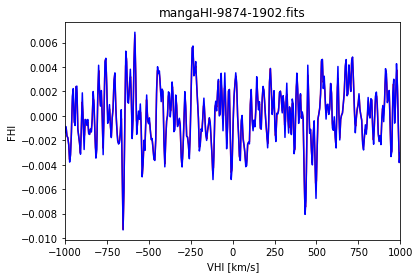

KeyboardInterrupt: 

In [15]:
#ALSO OVERPLOTS ORIGINAL AND INTERPOLATED DATA
d = [] #create empty list to put interpolated flux data (i.e. new_y2)
for f in drip_names: #goes through and pulls out VHI and FHI and galaxy velocity
    vel, flux, galv, corrected_vel = read_spec(f)
    corrected_vel2 = corrected_vel
    yeet=flux
    for p in corrected_vel2:
        for q in yeet:
            int_func = interpolate.interp1d(p,q,fill_value="extrapolate")
            new_x2 = np.arange(-1000,1000,5)
            new_y2 = int_func(new_x2)
            d.append(new_y2)
            figg = plt.figure()
            ax1 = figg.add_subplot(111)
            ax1.plot(new_x2,new_y2, color = 'red')
            ax1.plot(p,q, color = 'blue')
            plt.xlim(-1000,1000)
            fname = os.path.basename(f)
            plt.title(fname)
            plt.xlabel('VHI [km/s]')
            plt.ylabel('FHI')
            plt.show()
            plt.close()
            break

## Stacking and Final Plotting

Stacking and final plotting was done first for the geysers, then for the control sample. I repeated the process from the previous graphing cell for creating a new x and y data set after applying the interoplate function, but only for the red geysers this time. The new set of flux data for all red geyser galaxies is in e. e is like a matrix in that it is an array of arrays. 

The final loop in the following cell is the stacking loop where I summed across all arrays in scaled_fluxx_arr2 by index. The fact that each value in these flux arrays corresponds to the same VHI is what makes this summation possible. I subsequently divided by the sum of all of the noise weights. This was necessary in order to account for the varying range of data noisiness in the stack. We wanted more noisy data to be less present and vice versa. 

In [16]:
#stacking geysers

#interpolating through the red geyser flux
e = [] #where new interpolated flux matrix will go
for f in geys_names:
    vel, flux, galv, corrected_vel = read_spec(f)
    xee = corrected_vel
    yee=flux
    for p in xee:
        for q in yee:
            int_func = interpolate.interp1d(p,q,fill_value="extrapolate")
            geysx = np.arange(-1000,1000,5)
            geysy = int_func(geysx)
            e.append(geysy)


#scaling for distance loop
scaled_flux_arr2 = []
for i in range(len(e)):
    scaled_flux = (e[i])*(dat[i]) #multiply each distance weight dat by flux e
    scaled_flux_arr2.append(scaled_flux) #put into scaled_flux_arr2

#scaling for rms weights loop
scaled_fluxx_arr2 = []
for i in range(len(scaled_flux_arr2)):
    scaled_fluxx = (scaled_flux_arr2[i])*(fat[i]) #multiply each noise weight by scaled_flux_arr2
    scaled_fluxx_arr2.append(scaled_fluxx) #put into scaled_fluxx_arr2

#stacking loop
stacked_flux_arr2 = [] #final y data for red geyser stack
for i in range(len(e[0])):
    tot1 = (np.sum([l[i] for l in scaled_fluxx_arr2]))/wsum 
    stacked_flux_arr2.append(tot1)

## Final Stacked Red Geyser Plot

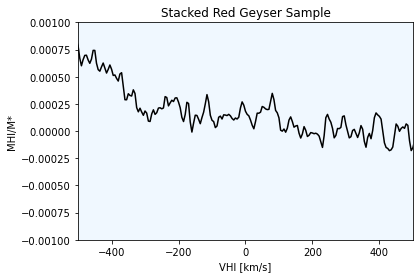

In [17]:
#plotting stacked red geyser sample
geysstackfig = plt.figure()
ax1 = geysstackfig.add_subplot(111)
ax1.set_facecolor("aliceblue")
arbx1 = np.arange(-1000,1000,5) #the same set of standard x points as new_x2
ax1.plot(arbx1,stacked_flux_arr2, color = 'k')
plt.xlim(-500,500)
plt.ylim(-0.001,0.001)
plt.title('Stacked Red Geyser Sample')
plt.xlabel('VHI [km/s]')
plt.ylabel('MHI/M*')
plt.savefig('stacked geysers.png', bbox_inches='tight')
plt.show()
plt.close()

##note that the HI gas-to-stellar mass ratio in this stacked red geyser sample deals with small numbers; not unlike Roberts-Borsani et al 2019

The same process for stacking and plotting was completed for our control sample below.

In [21]:
#stacking control sample

g = [] #array of interpolated control flux arrays
for f in cont_names: 
    vel, flux, galv, corrected_vel = read_spec(f)
    xee1 = corrected_vel
    yee1=flux
    for p in xee1:
        for q in yee1:
            int_func = interpolate.interp1d(p,q, fill_value="extrapolate")
            contx = np.arange(-1000,1000,5) #standard x values
            conty = int_func(contx)
            g.append(conty)


#scaling for distance loop
scaled_flux_arr3 = []
for i in range(len(g)):
    scaled_flux = (g[i])*(dat2[i])
    scaled_flux_arr3.append(scaled_flux)

#scaling for rms weights loop
scaled_fluxx_arr3 = []
for i in range(len(scaled_flux_arr3)):
    scaled_fluxx = (scaled_flux_arr3[i])*(fat2[i])
    scaled_fluxx_arr3.append(scaled_fluxx)

#stacking flux loop
stacked_flux_arr3 = [] #final y data for control stack
for i in range(len(g[0])):
    tot2 = (np.sum([l[i] for l in scaled_fluxx_arr3]))/wsum2
    stacked_flux_arr3.append(tot2)

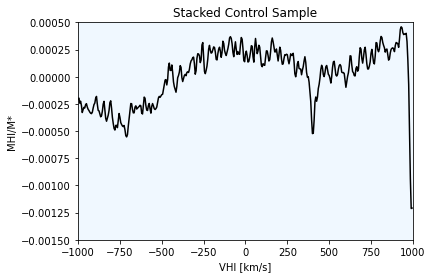

In [22]:
#plotting stacked control sample
contstackfig = plt.figure()
ax1 = contstackfig.add_subplot(111)
ax1.set_facecolor("aliceblue")
arbx = np.arange(-1000,1000,5)
ax1.plot(arbx,stacked_flux_arr3, color = 'k')
plt.xlim(-1000,1000)
plt.ylim(-0.0015,0.0005)
plt.title('Stacked Control Sample')
plt.xlabel('VHI [km/s]')
plt.ylabel('MHI/M*')
plt.savefig('stacked control.png', bbox_inches='tight')
plt.show()
plt.close()

## Analysis: Upper Limits

Since there is no immediately discernable HI emission in these stacked plots, we could not compare them and gain information about the respective HI gas-to-stellar mass ratio of our samples. However, we can compute the upper limit for this ratio using the following formula:

final rms $= 3(rms)dV \sqrt{\frac{W}{dV}}$

where rms is the standard deviation of our data measured at a flat part of our plot, $W = 200 km/s$ is the assumed linewidth of our galaxies, and $dV = 10 km/s$ is the velocity resolution of our data. The coefficient of 3 is motivated by the convention of quoting upper limits as 3 times the noise level. 

In [20]:
#calculate final rms noise to find upper limit on HI mass

#limit flux to -200 to 400 range since it's relatively flat
a=np.array(stacked_flux_arr2)
flatmask = (arbx1 > -200) & (arbx1 < 400) #red geyser stack is flat between [-200,200] VHI
flatflux = a[flatmask] #apply mask to slice out FHI data outisde of flat range
print(len(flatflux)) #this at least makes sense considering the fraction of arbx1 I'm pulling

#calculate standard deviation across this flat range
rmsdev = np.std(flatflux)
print('Standard deviation across red geyser stacked spectra from -200 to 400 VHI is',rmsdev)

#upper limit calc
dV = 10 #[km/s] does this come from GBT data?
W = 200 #[km/s] assumed linewidth of our galaxies
uplim = 3*rmsdev*dV*(np.sqrt(W/dV)) #"The factor of 3 is just to to be conservative...we tend to quote upper limits as 3 times the noise level." -Dave
print('The average red geyser has an HI-to-stellar-mass ratio less than',uplim, '[M_sun.]')

119
Standard deviation across red geyser stacked spectra from -200 to 400 VHI is 0.00010317029537830541
The average red geyser has an HI-to-stellar-mass ratio less than 0.013841747623477396 [M_sun.]


I repeated this calculation for our control sample as well, although the computed value is not useful. It is nice to have it on hand, I suppose.

In [24]:
#calculate final rms noise to find upper limit on HI mass control sample

#limit flux to -200 to 400 range since it's relatively flat
a2=np.array(stacked_flux_arr3)
flatmask2 = (arbx1 > -225) & (arbx1 < 225)
flatflux2 = a2[flatmask2]
#print(flatflux) #... I don't know how python knows which VHI are associated with what spectrum value because other than the plot, I didn't explicitly link them
print(len(flatflux)) #this at least makes sense considering the fraction of arbx1 I'm pulling

#calculate standard deviation across this range
rmsdev2 = np.std(flatflux2)
print('Standard deviation across control stacked spectra from -200 to 400 VHI is',rmsdev)

#upper limit calc
dV = 10 #[km/s] does this come from GBT data?
W = 200 #[km/s] assumed linewidth of our galaxies
uplim2 = 3*rmsdev2*dV*(np.sqrt(W/dV)) #"The factor of 3 is just to to be conservative...we tend to quote upper limits as 3 times the noise level." -Dave
print('The average control sample galaxy has an HI-to-stellar-mass ratio less than',uplim2, '[M_sun.]')

119
Standard deviation across control stacked spectra from -200 to 400 VHI is 0.00010317029537830541
The average control sample galaxy has an HI-to-stellar-mass ratio less than 0.008861651130211892 [M_sun.]
